In [1]:
import pandas as pd
import numpy as np
import scanpy as sc
import matplotlib as mpl
mpl.rcParams['pdf.fonttype'] = 42
import matplotlib.pyplot as plt
import seaborn as sns
import scvi
from statsmodels.stats import weightstats as stests

from matplotlib import rcParams

Global seed set to 0


Load the trained model and generate the pseudobulk dataframe

In [2]:
adata = scvi.data.read_h5ad("/Users/peien/NYU Langone Health Dropbox/Peien Jiang/evolution/PETRI_D2D4D23_250117/onlymRNA_scVI_JE2_D2D4D23_g20250117_seed12.h5ad")

/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


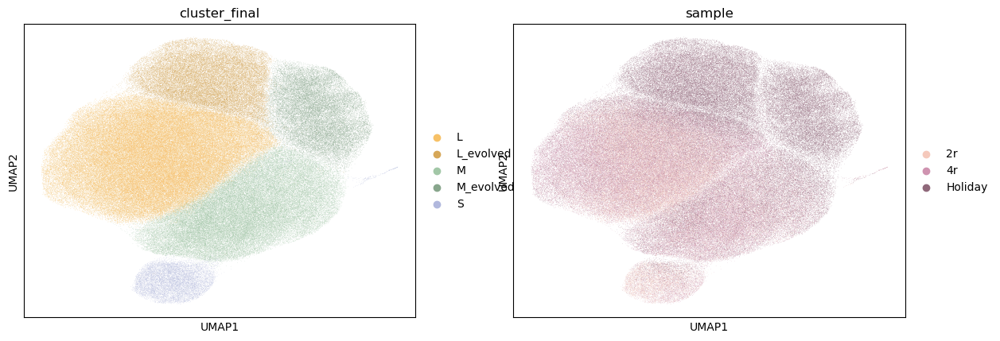

In [3]:
sc.pl.umap(adata, 
           color=["cluster_final",'sample'],
          )

In [5]:
X = adata.raw.X                  # raw counts matrix
genes = adata.raw.var_names      # genes in raw
samples = adata.obs['cluster_final'].astype(str).to_numpy()
uniq = pd.unique(samples)

rows = []
for s in uniq:
    mask = samples == s
    Xs = X[mask]
    rows.append(np.asarray(Xs.sum(axis=0)).ravel())

sum_df = pd.DataFrame(rows, index=uniq, columns=genes) 
sum_df

,dnaA,dnaN,SAUSA300_RS00020,recF,gyrB,gyrA,nnrD,hutH,serS,SAUSA300_RS00055,...,SAUSA300_RS15495,SAUSA300_RS15500,SAUSA300_RS15580,SAUSA300_RS15635,SAUSA300_RS15725,SAUSA300_RS15795,SAUSA300_RS15905,opp-4F,SAUSA300_RS08080,SAUSA300_RS10575
M,1442.0,1474.0,98.0,1524.0,4669.0,5257.0,117.0,45.0,1014.0,56.0,...,6.0,7.0,7.0,15.0,7.0,23.0,16.0,4.0,7.0,0.0
L,4551.0,4543.0,258.0,4164.0,12698.0,15183.0,336.0,122.0,3028.0,157.0,...,8.0,7.0,22.0,41.0,21.0,49.0,65.0,19.0,16.0,1.0
S,154.0,139.0,11.0,105.0,241.0,229.0,185.0,67.0,57.0,11.0,...,244.0,117.0,12.0,23.0,0.0,3.0,1.0,2.0,12.0,25.0
L_evolved,1154.0,1251.0,60.0,1080.0,3425.0,3909.0,101.0,42.0,805.0,32.0,...,3.0,1.0,3.0,12.0,7.0,17.0,12.0,2.0,5.0,1.0
M_evolved,509.0,610.0,23.0,572.0,1825.0,2119.0,39.0,27.0,407.0,15.0,...,0.0,2.0,5.0,4.0,2.0,11.0,7.0,2.0,1.0,0.0


In [6]:
sum_df.to_csv("holiday_cluster_final_sum.csv")

scVI analysis

In [2]:
scvi.settings.seed = 12

Global seed set to 12


In [ ]:
BS28141A_g = pd.read_csv("]BS28141A_g_v11_threshold_0_mixed_species_gene_matrix.txt", sep="\t", index_col=0)
BS28142A_g = pd.read_csv("BS28142A_g_v11_threshold_0_mixed_species_gene_matrix.txt", sep="\t", index_col=0)
BS28143A_g = pd.read_csv("BS28143A_g_v11_threshold_0_mixed_species_gene_matrix.txt", sep="\t", index_col=0)
BS28144A_g = pd.read_csv("BS28144A_g_v11_threshold_0_mixed_species_gene_matrix.txt", sep="\t", index_col=0)
BS28145A_g = pd.read_csv("BS28145A_g_v11_threshold_0_mixed_species_gene_matrix.txt", sep="\t", index_col=0)
BS28146A_g = pd.read_csv("BS28146A_g_v11_threshold_0_mixed_species_gene_matrix.txt", sep="\t", index_col=0)
BS28147A_g = pd.read_csv("BS28147A_g_v11_threshold_0_mixed_species_gene_matrix.txt", sep="\t", index_col=0)
BS28148A_g = pd.read_csv("BS28148A_g_v11_threshold_0_mixed_species_gene_matrix.txt", sep="\t", index_col=0)


In [4]:
counts = pd.concat([BS28141A_g,BS28142A_g,BS28143A_g,BS28144A_g,BS28145A_g,BS28146A_g,BS28147A_g,BS28148A_g],axis=0).fillna(0)
counts

,NC_007793.1:SAUSA300_RS00010,NC_007793.1:SAUSA300_RS00015,NC_007793.1:SAUSA300_RS00020,NC_007793.1:SAUSA300_RS00025,NC_007793.1:SAUSA300_RS00030,NC_007793.1:SAUSA300_RS00035,NC_007793.1:SAUSA300_RS00040,NC_007793.1:SAUSA300_RS00045,NC_007793.1:SAUSA300_RS00050,NC_007793.1:SAUSA300_RS00055,...,NC_007793.1:SAUSA300_RS02170,NC_007793.1:SAUSA300_RS15540,NC_007793.1:SAUSA300_RS15730,NC_007793.1:SAUSA300_RS02670,NC_007793.1:SAUSA300_RS05130,NC_007793.1:SAUSA300_RS14040,NC_007793.1:SAUSA300_RS15890,NC_007793.1:SAUSA300_RS09120,NC_007793.1:SAUSA300_RS09155,NC_007793.1:SAUSA300_RS14140
Cell Barcode,,,,,,,,,,,,,,,,,,,,,
BS28141A_bc1_10_bc2_10_bc3_24,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28141A_bc1_10_bc2_10_bc3_46,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28141A_bc1_10_bc2_10_bc3_52,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28141A_bc1_10_bc2_10_bc3_96,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28141A_bc1_10_bc2_11_bc3_16,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
BS28148A_bc1_9_bc2_96_bc3_83,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28148A_bc1_9_bc2_9_bc3_41,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28148A_bc1_9_bc2_9_bc3_44,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [5]:
del BS28141A_g
del BS28142A_g
del BS28143A_g
del BS28144A_g
del BS28145A_g
del BS28146A_g
del BS28147A_g
del BS28148A_g

In [6]:
counts.columns = counts.columns.str[12:]
counts  

,SAUSA300_RS00010,SAUSA300_RS00015,SAUSA300_RS00020,SAUSA300_RS00025,SAUSA300_RS00030,SAUSA300_RS00035,SAUSA300_RS00040,SAUSA300_RS00045,SAUSA300_RS00050,SAUSA300_RS00055,...,SAUSA300_RS02170,SAUSA300_RS15540,SAUSA300_RS15730,SAUSA300_RS02670,SAUSA300_RS05130,SAUSA300_RS14040,SAUSA300_RS15890,SAUSA300_RS09120,SAUSA300_RS09155,SAUSA300_RS14140
Cell Barcode,,,,,,,,,,,,,,,,,,,,,
BS28141A_bc1_10_bc2_10_bc3_24,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28141A_bc1_10_bc2_10_bc3_46,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28141A_bc1_10_bc2_10_bc3_52,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28141A_bc1_10_bc2_10_bc3_96,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28141A_bc1_10_bc2_11_bc3_16,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
BS28148A_bc1_9_bc2_96_bc3_83,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28148A_bc1_9_bc2_9_bc3_41,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28148A_bc1_9_bc2_9_bc3_44,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [7]:
gff = pd.read_csv("/Users/peien/Dropbox (NYU Langone Health)/evolution/USA300_FPR3757_rRNA_edited.txt", header=None, sep="\t")
gff

,0,1,2,3,4,5,6,7,8
0,NC_007793.1,RefSeq,region,1,2872769,.,+,.,ID=NC_007793.1:1..2872769;Dbxref=taxon:451515;...
1,NC_007793.1,RefSeq,gene,544,1905,.,+,.,ID=gene-SAUSA300_RS00010;Name=dnaA;gbkey=Gene;...
2,NC_007793.1,Protein Homology,CDS,544,1905,.,+,0,ID=cds-WP_001290433.1;Parent=gene-SAUSA300_RS0...
3,NC_007793.1,RefSeq,gene,2183,3316,.,+,.,ID=gene-SAUSA300_RS00015;Name=dnaN;gbkey=Gene;...
4,NC_007793.1,Protein Homology,CDS,2183,3316,.,+,0,ID=cds-WP_000969811.1;Parent=gene-SAUSA300_RS0...
...,...,...,...,...,...,...,...,...,...
5937,NC_007793.1,custom,gene,2001081,2001171,.,-,.,locus_tag=pre_rRNA
5938,NC_007793.1,custom,gene,2175926,2175997,.,-,.,locus_tag=pre_rRNA
5939,NC_007793.1,custom,gene,2178921,2179468,.,-,.,locus_tag=pre_rRNA
5940,NC_007793.1,custom,gene,2292480,2292551,.,-,.,locus_tag=pre_rRNA


In [8]:
rRNA = gff[gff[2]=="rRNA"][8].str.extract('locus_tag=(.{,16})').values.tolist()
rRNA.append(['pre_rRNA'])
rRNA

[['SAUSA300_RS02440'],
 ['SAUSA300_RS02445'],
 ['SAUSA300_RS02450'],
 ['SAUSA300_RS02665'],
 ['SAUSA300_RS02675'],
 ['SAUSA300_RS02685'],
 ['SAUSA300_RS02690'],
 ['SAUSA300_RS10035'],
 ['SAUSA300_RS10040'],
 ['SAUSA300_RS10055'],
 ['SAUSA300_RS11085'],
 ['SAUSA300_RS11090'],
 ['SAUSA300_RS11095'],
 ['SAUSA300_RS11685'],
 ['SAUSA300_RS11690'],
 ['SAUSA300_RS11695'],
 ['pre_rRNA']]

In [9]:
tRNA = gff[gff[2]=="tRNA"][8].str.extract('locus_tag=(.{,16})').values.tolist()
tRNA

[['SAUSA300_RS00095'],
 ['SAUSA300_RS00100'],
 ['SAUSA300_RS02390'],
 ['SAUSA300_RS02670'],
 ['SAUSA300_RS02680'],
 ['SAUSA300_RS04975'],
 ['SAUSA300_RS04980'],
 ['SAUSA300_RS05785'],
 ['SAUSA300_RS09700'],
 ['SAUSA300_RS09705'],
 ['SAUSA300_RS09710'],
 ['SAUSA300_RS09715'],
 ['SAUSA300_RS09720'],
 ['SAUSA300_RS09725'],
 ['SAUSA300_RS09730'],
 ['SAUSA300_RS09735'],
 ['SAUSA300_RS09910'],
 ['SAUSA300_RS15810'],
 ['SAUSA300_RS09915'],
 ['SAUSA300_RS09920'],
 ['SAUSA300_RS09925'],
 ['SAUSA300_RS09930'],
 ['SAUSA300_RS09935'],
 ['SAUSA300_RS09940'],
 ['SAUSA300_RS09945'],
 ['SAUSA300_RS09950'],
 ['SAUSA300_RS09955'],
 ['SAUSA300_RS09960'],
 ['SAUSA300_RS09965'],
 ['SAUSA300_RS09970'],
 ['SAUSA300_RS09975'],
 ['SAUSA300_RS09980'],
 ['SAUSA300_RS09985'],
 ['SAUSA300_RS09990'],
 ['SAUSA300_RS09995'],
 ['SAUSA300_RS10000'],
 ['SAUSA300_RS10005'],
 ['SAUSA300_RS10010'],
 ['SAUSA300_RS10015'],
 ['SAUSA300_RS10020'],
 ['SAUSA300_RS10025'],
 ['SAUSA300_RS10030'],
 ['SAUSA300_RS10045'],
 ['SAUSA300

In [11]:
counts_sum = pd.DataFrame(columns=['mRNA', 'tRNA', 'rRNA'])
counts_sum['tRNA'] = counts[np.intersect1d(counts.columns, tRNA)].sum(axis=1)
counts_sum['rRNA'] = counts[np.intersect1d(counts.columns, rRNA)].sum(axis=1)
counts_sum['mRNA'] = counts.sum(axis=1)-counts_sum['tRNA']-counts_sum['rRNA']
counts_sum['rRNA/mRNA'] = counts_sum['rRNA']/counts_sum['mRNA']
counts_sum

,mRNA,tRNA,rRNA,rRNA/mRNA
Cell Barcode,,,,
BS28141A_bc1_10_bc2_10_bc3_24,27.0,0.0,2.0,0.074074
BS28141A_bc1_10_bc2_10_bc3_46,4.0,0.0,1.0,0.250000
BS28141A_bc1_10_bc2_10_bc3_52,95.0,0.0,0.0,0.000000
BS28141A_bc1_10_bc2_10_bc3_96,45.0,0.0,1.0,0.022222
BS28141A_bc1_10_bc2_11_bc3_16,47.0,0.0,1.0,0.021277
...,...,...,...,...
BS28148A_bc1_9_bc2_96_bc3_83,17.0,0.0,1.0,0.058824
BS28148A_bc1_9_bc2_9_bc3_41,30.0,0.0,2.0,0.066667
BS28148A_bc1_9_bc2_9_bc3_44,107.0,0.0,2.0,0.018692


In [12]:
counts_sum.to_csv("counts_sum.csv")

In [10]:
counts = counts.drop(np.intersect1d(counts.columns, tRNA),axis=1)
counts

,SAUSA300_RS00010,SAUSA300_RS00015,SAUSA300_RS00020,SAUSA300_RS00025,SAUSA300_RS00030,SAUSA300_RS00035,SAUSA300_RS00040,SAUSA300_RS00045,SAUSA300_RS00050,SAUSA300_RS00055,...,SAUSA300_RS02125,SAUSA300_RS02170,SAUSA300_RS15540,SAUSA300_RS15730,SAUSA300_RS05130,SAUSA300_RS14040,SAUSA300_RS15890,SAUSA300_RS09120,SAUSA300_RS09155,SAUSA300_RS14140
Cell Barcode,,,,,,,,,,,,,,,,,,,,,
BS28141A_bc1_10_bc2_10_bc3_24,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28141A_bc1_10_bc2_10_bc3_46,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28141A_bc1_10_bc2_10_bc3_52,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28141A_bc1_10_bc2_10_bc3_96,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28141A_bc1_10_bc2_11_bc3_16,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
BS28148A_bc1_9_bc2_96_bc3_83,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28148A_bc1_9_bc2_9_bc3_41,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28148A_bc1_9_bc2_9_bc3_44,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [11]:
counts = counts.drop(np.intersect1d(counts.columns, rRNA),axis=1)
counts

,SAUSA300_RS00010,SAUSA300_RS00015,SAUSA300_RS00020,SAUSA300_RS00025,SAUSA300_RS00030,SAUSA300_RS00035,SAUSA300_RS00040,SAUSA300_RS00045,SAUSA300_RS00050,SAUSA300_RS00055,...,SAUSA300_RS02125,SAUSA300_RS02170,SAUSA300_RS15540,SAUSA300_RS15730,SAUSA300_RS05130,SAUSA300_RS14040,SAUSA300_RS15890,SAUSA300_RS09120,SAUSA300_RS09155,SAUSA300_RS14140
Cell Barcode,,,,,,,,,,,,,,,,,,,,,
BS28141A_bc1_10_bc2_10_bc3_24,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28141A_bc1_10_bc2_10_bc3_46,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28141A_bc1_10_bc2_10_bc3_52,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28141A_bc1_10_bc2_10_bc3_96,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28141A_bc1_10_bc2_11_bc3_16,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
BS28148A_bc1_9_bc2_96_bc3_83,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28148A_bc1_9_bc2_9_bc3_41,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28148A_bc1_9_bc2_9_bc3_44,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
import json
with open('gene_rename.json', 'r') as f:
    rename_dict = json.load(f)
rename_dict

{'SAUSA300_RS00010': 'dnaA',
 'SAUSA300_RS00015': 'dnaN',
 'SAUSA300_RS00020': 'SAUSA300_RS00020',
 'SAUSA300_RS00025': 'recF',
 'SAUSA300_RS00030': 'gyrB',
 'SAUSA300_RS00035': 'gyrA',
 'SAUSA300_RS00040': 'nnrD',
 'SAUSA300_RS00045': 'hutH',
 'SAUSA300_RS14945': 'SAUSA300_RS14945',
 'SAUSA300_RS00050': 'serS',
 'SAUSA300_RS00055': 'SAUSA300_RS00055',
 'SAUSA300_RS00060': 'SAUSA300_RS00060',
 'SAUSA300_RS00065': 'metX',
 'SAUSA300_RS00070': 'SAUSA300_RS00070',
 'SAUSA300_RS00075': 'gdpP',
 'SAUSA300_RS00080': 'rplI',
 'SAUSA300_RS00085': 'dnaC',
 'SAUSA300_RS14950': 'SAUSA300_RS14950',
 'SAUSA300_RS00090': 'purA',
 'SAUSA300_RS00095': 'SAUSA300_RS00095',
 'SAUSA300_RS00100': 'SAUSA300_RS00100',
 'SAUSA300_RS00105': 'walR',
 'SAUSA300_RS00110': 'walK',
 'SAUSA300_RS00115': 'walH',
 'SAUSA300_RS00120': 'walI',
 'SAUSA300_RS00125': 'walJ',
 'SAUSA300_RS00130': 'adsA',
 'SAUSA300_RS00135': 'orfX',
 'SAUSA300_RS00140': 'SAUSA300_RS00140',
 'SAUSA300_RS00145': 'SAUSA300_RS00145',
 'SAUSA300

In [13]:
counts.columns = [rename_dict.get(col, col) for col in counts.columns]
counts

,dnaA,dnaN,SAUSA300_RS00020,recF,gyrB,gyrA,nnrD,hutH,serS,SAUSA300_RS00055,...,SAUSA300_RS02125,SAUSA300_RS02170,SAUSA300_RS15540,SAUSA300_RS15730,SAUSA300_RS05130,SAUSA300_RS14040,SAUSA300_RS15890,SAUSA300_RS09120,SAUSA300_RS09155,SAUSA300_RS14140
Cell Barcode,,,,,,,,,,,,,,,,,,,,,
BS28141A_bc1_10_bc2_10_bc3_24,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28141A_bc1_10_bc2_10_bc3_46,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28141A_bc1_10_bc2_10_bc3_52,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28141A_bc1_10_bc2_10_bc3_96,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28141A_bc1_10_bc2_11_bc3_16,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
BS28148A_bc1_9_bc2_96_bc3_83,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28148A_bc1_9_bc2_9_bc3_41,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BS28148A_bc1_9_bc2_9_bc3_44,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [14]:
# Get strain info
bc1_lookup = []
for i in range(1,97):
    if i <= 24:
        bc1_lookup.append('2r')
    elif 25 <= i <= 60:
        bc1_lookup.append('4r')
    elif 61 <= i <= 96:
        bc1_lookup.append('23r')
    else:
        raise ValueError (str(i) + ' should not be a value.')
bc1_lookup = np.array(bc1_lookup)
bc1 = counts.index.str.replace('.*_bc1_', '', regex=True).\
    str.replace('_bc2_.*', '', regex=True).astype(int)

sample_label = pd.Series(bc1_lookup[bc1.to_numpy() - 1], index=counts.index)
sample_label

Cell Barcode
BS28141A_bc1_10_bc2_10_bc3_24    2r
BS28141A_bc1_10_bc2_10_bc3_46    2r
BS28141A_bc1_10_bc2_10_bc3_52    2r
BS28141A_bc1_10_bc2_10_bc3_96    2r
BS28141A_bc1_10_bc2_11_bc3_16    2r
                                 ..
BS28148A_bc1_9_bc2_96_bc3_83     2r
BS28148A_bc1_9_bc2_9_bc3_41      2r
BS28148A_bc1_9_bc2_9_bc3_44      2r
BS28148A_bc1_9_bc2_9_bc3_85      2r
BS28148A_bc1_9_bc2_9_bc3_95      2r
Length: 395521, dtype: object

In [15]:
adata = sc.AnnData(counts)
#look at statistics
sc.pp.calculate_qc_metrics(adata, inplace=True)

/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/preprocessing/_qc.py:422: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]


In [16]:
adata.obs['sample'] = sample_label
adata.obs

,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,sample
Cell Barcode,,,,,,,,,
BS28141A_bc1_10_bc2_10_bc3_24,23,3.178054,27.0,3.332205,100.000000,100.0,100.0,100.0,2r
BS28141A_bc1_10_bc2_10_bc3_46,4,1.609438,4.0,1.609438,100.000000,100.0,100.0,100.0,2r
BS28141A_bc1_10_bc2_10_bc3_52,67,4.219508,95.0,4.564348,82.105263,100.0,100.0,100.0,2r
BS28141A_bc1_10_bc2_10_bc3_96,38,3.663562,45.0,3.828641,100.000000,100.0,100.0,100.0,2r
BS28141A_bc1_10_bc2_11_bc3_16,43,3.784190,47.0,3.871201,100.000000,100.0,100.0,100.0,2r
...,...,...,...,...,...,...,...,...,...
BS28148A_bc1_9_bc2_96_bc3_83,17,2.890372,17.0,2.890372,100.000000,100.0,100.0,100.0,2r
BS28148A_bc1_9_bc2_9_bc3_41,27,3.332205,30.0,3.433987,100.000000,100.0,100.0,100.0,2r
BS28148A_bc1_9_bc2_9_bc3_44,66,4.204693,107.0,4.682131,85.046729,100.0,100.0,100.0,2r


In [17]:
adata.obs['sample'].value_counts()

4r     157269
23r    150088
2r      88164
Name: sample, dtype: int64

In [18]:
del counts

<Axes: ylabel='Frequency'>

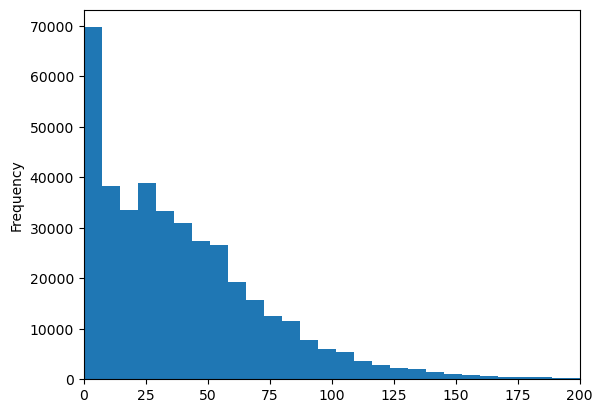

In [21]:
adata.obs['total_counts'].plot.hist(bins=100, xlim=(0,200))

<Axes: ylabel='Frequency'>

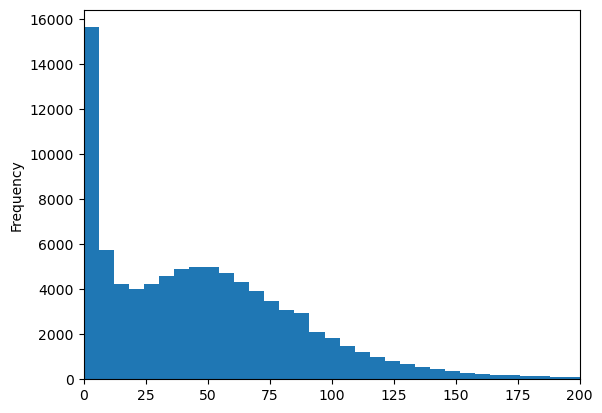

In [22]:
adata[adata.obs['sample']=='2r'].obs['total_counts'].plot.hist(bins=100, xlim=(0,200))

<Axes: ylabel='Frequency'>

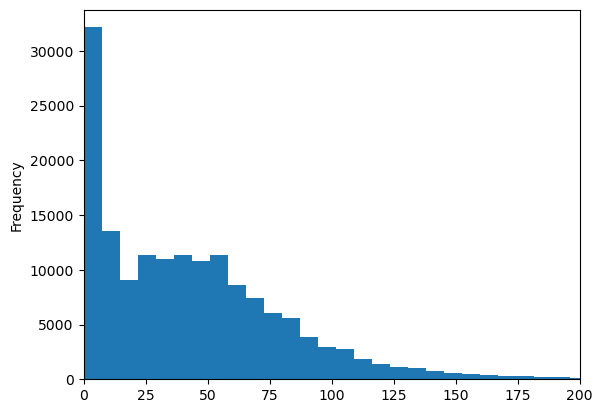

In [23]:
adata[adata.obs['sample']=='4r'].obs['total_counts'].plot.hist(bins=100, xlim=(0,200))

<Axes: ylabel='Frequency'>

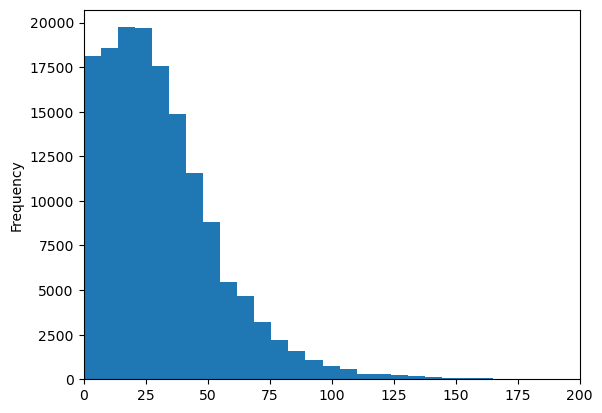

In [24]:
adata[adata.obs['sample']=='23r'].obs['total_counts'].plot.hist(bins=100, xlim=(0,200))

In [19]:
#filter
sc.pp.filter_genes(adata, min_counts=30, inplace=True)
sc.pp.filter_cells(adata, min_counts=15, inplace=True)
adata.obs['sample'].value_counts()

4r     111585
23r    110540
2r      65309
Name: sample, dtype: int64

In [20]:
adata.raw = adata # Freeze current version

scvi.data.setup_anndata(adata)

model = scvi.model.SCVI(adata,
                        n_layers=2,
                        n_latent=5,
                        n_hidden=64,
                        dropout_rate=0.1,
                        gene_likelihood='zinb',
                        dispersion='gene'
                       )
model.train()

INFO     No batch_key inputted, assuming all cells are same batch                            
INFO     No label_key inputted, assuming all cells have same label                           
INFO     Using data from adata.X                                                             
INFO     Successfully registered anndata object containing 287434 cells, 2507 vars, 1        
         batches, 1 labels, and 0 proteins. Also registered 0 extra categorical covariates   
         and 0 extra continuous covariates.                                                  
INFO     Please do not further modify adata until model is trained.                          


/Users/peien/opt/anaconda3/lib/python3.8/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function setup_anndata is deprecated; Please use the model-specific setup_anndata methods instead. The global method will be removed in version 0.15.0.
  warnings.warn(msg, category=FutureWarning)
GPU available: False, used: False
TPU available: False, using: 0 TPU cores


Epoch 28/28: 100%|███████████| 28/28 [46:06<00:00, 98.80s/it, loss=162, v_num=1]


In [21]:
latent = model.get_latent_representation()
adata.obsm["X_scVI"] = latent

In [22]:
adata.layers["scvi_normalized"] = model.get_normalized_expression(
    library_size=10e4
)

In [24]:
sc.pp.neighbors(adata, use_rep='X_scVI')
sc.tl.umap(adata)

/Users/peien/opt/anaconda3/lib/python3.8/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/Users/peien/opt/anaconda3/lib/python3.8/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/Users/peien/opt/anaconda3/lib/python3.8/site-packages/umap/distances.py:1086: NumbaDepr

/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


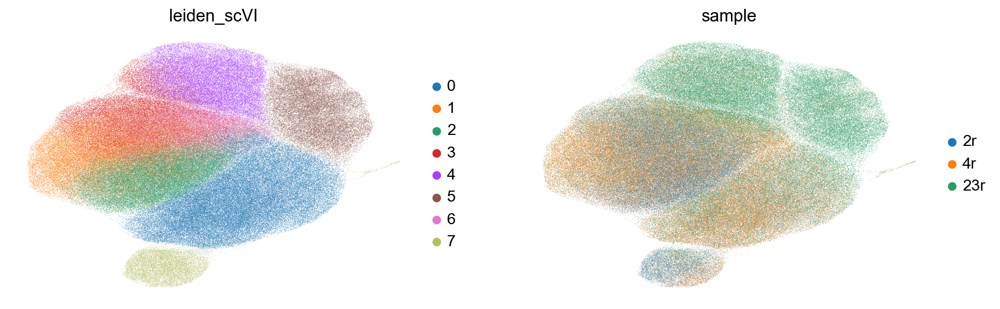

In [32]:
#Clustering on the scVI latent space

sc.tl.leiden(adata, key_added="leiden_scVI", resolution=0.2)
sc.set_figure_params(figsize=(6, 4))
sc.pl.umap(
    adata,
    color=["leiden_scVI","sample"],
    frameon=False,
    save="leiden_scVI.pdf"
)

In [4]:
adata = scvi.data.read_h5ad("/Users/peien/NYU Langone Health Dropbox/Peien Jiang/evolution/PETRI_D2D4D23_250117/onlymRNA_scVI_JE2_D2D4D23_g20250117_seed12.h5ad")
model = scvi.model.SCVI.load('onlymRNA_model_scVI_JE2_D2D4D23_g20250117_seed12', adata)

INFO     Using data from adata.X                                                             
INFO     Registered keys:['X', 'batch_indices', 'labels']                                    
INFO     Successfully registered anndata object containing 287434 cells, 2507 vars, 1        
         batches, 1 labels, and 0 proteins. Also registered 0 extra categorical covariates   
         and 0 extra continuous covariates.                                                  


/Users/peien/opt/anaconda3/lib/python3.8/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function transfer_anndata_setup is deprecated; This method will be removed in 0.15.0. Please avoid building any new dependencies on it.
  warnings.warn(msg, category=FutureWarning)


In [8]:
adata.obs['leiden_scVI_final'] = adata.obs['leiden_scVI2'].copy()
adata.obs['leiden_scVI_final'] = adata.obs['leiden_scVI_final'].cat.add_categories(['4'])
adata.obs.loc[adata.obs['leiden_scVI']=='5', 'leiden_scVI_final'] = '4'

/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


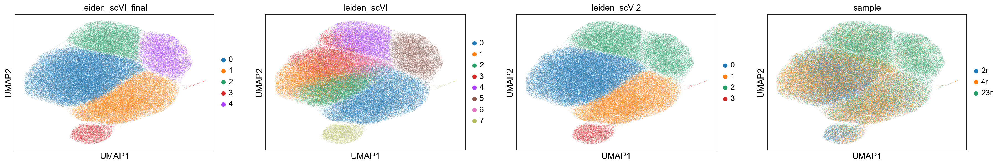

In [71]:
sc.set_figure_params(figsize=(6, 4))
sc.pl.umap(adata, 
           color=["leiden_scVI_final","leiden_scVI","leiden_scVI2",'sample'],
           save="leiden_scVI_final.pdf"
          )

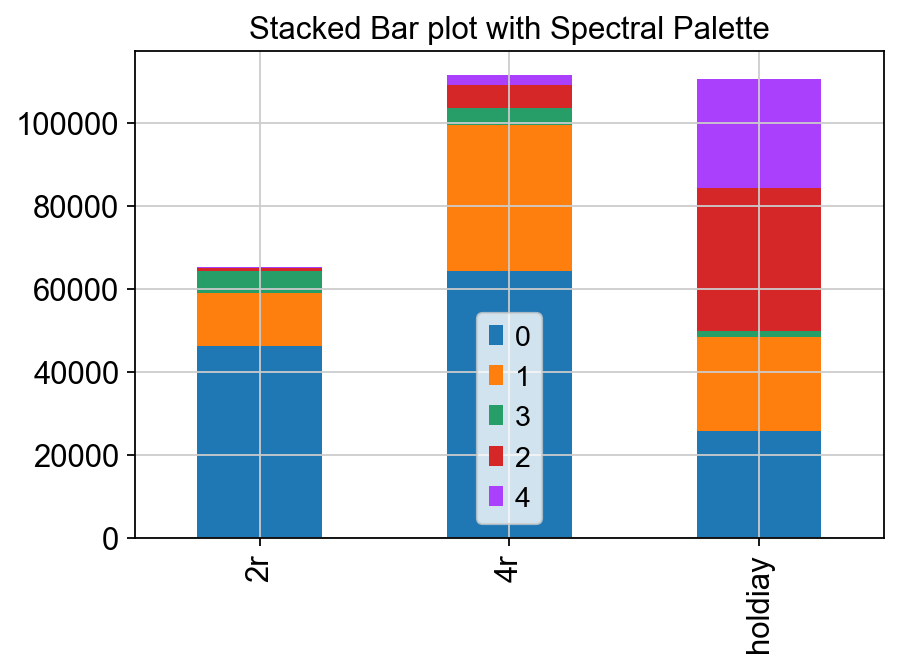

In [12]:
sample0 = adata.obs.loc[adata.obs['sample']=='2r', :]['leiden_scVI_final'].value_counts()
sample1 = adata.obs.loc[adata.obs['sample']=='4r', :]['leiden_scVI_final'].value_counts()
sample2 = adata.obs.loc[adata.obs['sample']=='23r', :]['leiden_scVI_final'].value_counts()
df_plot = pd.DataFrame([sample0,sample1, sample2])
df_plot.index=['2r','4r','holdiay']
df_plot.plot(kind='bar',stacked=True, title='Stacked Bar plot with Spectral Palette');

In [24]:
df_plot = df_plot.rename(columns={'0':'L',
                                  '1':'M',
                                  '2':'L_evolved',
                                  '3':'S',
                                  '4':'M_evolved'})
df_plot = df_plot[['S','M_evolved','M','L_evolved','L']]
df_plot

,S,M_evolved,M,L_evolved,L
2r,5466,231,12708,694,46210
4r,3956,2524,35125,5597,64383
holdiay,1585,26377,22645,34294,25639


<Figure size 320x336 with 0 Axes>

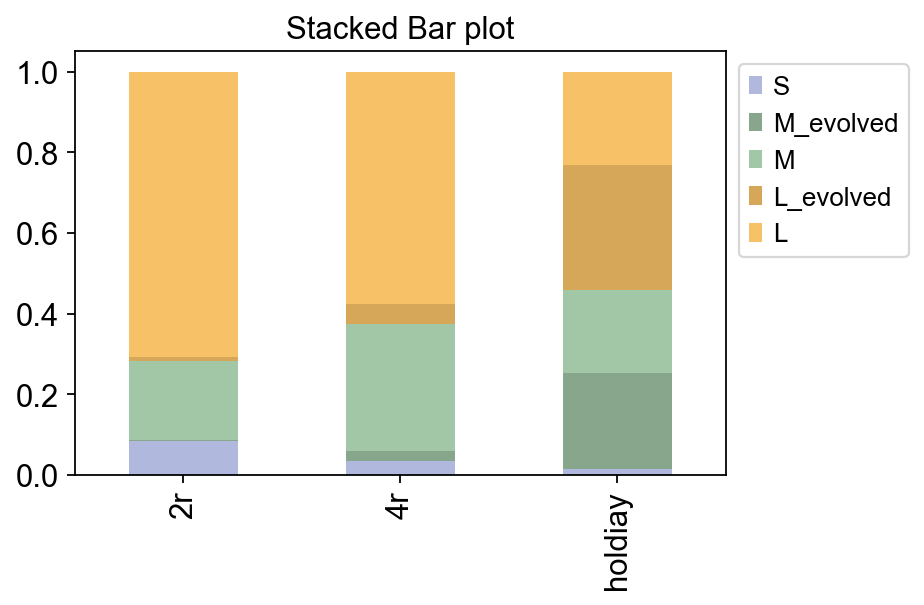

In [70]:
plt.figure(figsize=(4,4.2))
ax = df_plot.div(df_plot.sum(axis=1),axis=0).plot(
    kind='bar',stacked=True, 
    color=['#B1B8DD','#88a68c','#A2C7A7', '#d6a758','#F7C167'], #palette={'L':"#F7C167",'L_evolved':"#d6a758",'M':"#A2C7A7",'M_evolved':"#88a68c",'S':"#B1B8DD"},
    title='Stacked Bar plot')
# Remove gridlines
ax.grid(False)
plt.legend(bbox_to_anchor=(1.0, 1.0), fontsize="small")
plt.tight_layout()
plt.savefig("stacked_cluster_final.pdf")

In [69]:
df_plot

,S,M_evolved,M,L_evolved,L
2r,5466,231,12708,694,46210
4r,3956,2524,35125,5597,64383
holdiay,1585,26377,22645,34294,25639


In [53]:
de_df = model.differential_expression(
    groupby="leiden_scVI_final"
)
de_df

DE...: 100%|██████████████████████████████████████| 5/5 [01:35<00:00, 19.07s/it]


,proba_de,proba_not_de,bayes_factor,scale1,scale2,pseudocounts,delta,lfc_mean,lfc_median,lfc_std,...,raw_mean1,raw_mean2,non_zeros_proportion1,non_zeros_proportion2,raw_normalized_mean1,raw_normalized_mean2,is_de_fdr_0.05,comparison,group1,group2
carB,0.9794,0.0206,3.861649,0.003226,0.000552,0.0,0.25,5.551223,5.711942,5.157478,...,0.235128,0.029914,0.185881,0.026541,41.364419,6.590128,True,0 vs Rest,0,Rest
pyrC,0.9770,0.0230,3.748992,0.000975,0.000208,0.0,0.25,4.302565,4.447983,4.401957,...,0.068009,0.009656,0.061968,0.009028,12.141754,2.169199,True,0 vs Rest,0,Rest
pyrP,0.9750,0.0250,3.663561,0.000556,0.000129,0.0,0.25,3.824582,3.925875,4.428942,...,0.040974,0.006409,0.038178,0.006104,7.340601,1.434814,True,0 vs Rest,0,Rest
pyrB,0.9730,0.0270,3.584547,0.000594,0.000125,0.0,0.25,4.050523,4.184530,4.344279,...,0.047258,0.006825,0.043954,0.006567,8.389750,1.537874,True,0 vs Rest,0,Rest
ldh1,0.9728,0.0272,3.576961,0.002109,0.000592,0.0,0.25,3.886863,3.995127,4.512472,...,0.151396,0.037486,0.120801,0.032288,29.912551,8.454392,True,0 vs Rest,0,Rest
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
moaA,0.4928,0.5072,-0.028802,0.000266,0.000277,0.0,0.25,-0.044936,-0.042065,0.400625,...,0.011156,0.015370,0.011053,0.015114,2.771017,2.786726,False,4 vs Rest,4,Rest
SAUSA300_RS15115,0.4844,0.5156,-0.062420,0.000245,0.000266,0.0,0.25,-0.110869,-0.112844,0.371118,...,0.008822,0.012218,0.008685,0.012114,2.102486,2.216762,False,4 vs Rest,4,Rest
lysS,0.4786,0.5214,-0.085652,0.000862,0.000872,0.0,0.25,-0.018852,-0.007417,0.377559,...,0.037073,0.051904,0.035974,0.049605,9.484147,9.595542,False,4 vs Rest,4,Rest
sstA,0.4632,0.5368,-0.147467,0.000062,0.000059,0.0,0.25,0.084419,0.072430,0.385446,...,0.002094,0.002772,0.002094,0.002756,0.560823,0.499429,False,4 vs Rest,4,Rest


In [55]:
markers = {}
cats = adata.obs['leiden_scVI_final'].cat.categories
for i, c in enumerate(cats):
    cid = "{} vs Rest".format(c)
    cell_type_df = de_df.loc[de_df.comparison == cid]

    cell_type_df = cell_type_df[cell_type_df.lfc_mean > 0]

    cell_type_df = cell_type_df[cell_type_df["bayes_factor"] > 2]
    cell_type_df = cell_type_df[cell_type_df["non_zeros_proportion1"] > 0.05]

    markers[c] = cell_type_df.index.tolist()[:10]
    
markers

{'0': ['carB', 'pyrC', 'ldh1', 'lctP2', 'sdrD', 'spa', 'dnaK', 'rplJ', 'pycA'],
 '1': [],
 '2': ['purM',
  'purN',
  'purH',
  'purF',
  'purD',
  'purQ',
  'purC',
  'purL',
  'carB',
  'purK'],
 '3': ['SAUSA300_RS13710',
  'sdaAA',
  'sdaAB',
  'cstA',
  'clpB',
  'cstB',
  'est',
  'sasA',
  'ausA',
  'hrcA'],
 '4': ['purH',
  'purM',
  'purF',
  'purN',
  'purC',
  'purD',
  'purQ',
  'purK',
  'purL',
  'pbuG']}

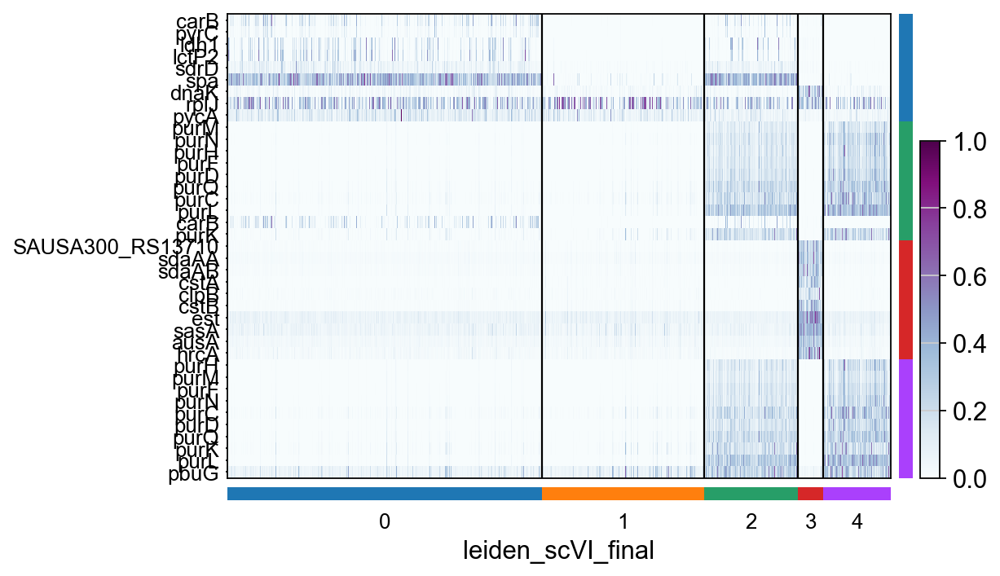

In [56]:
# Plot the heatmap with the downsampled data
sc.pl.heatmap(
    adata,
    markers,
    groupby='leiden_scVI_final',
    layer="scvi_normalized",
    standard_scale="var",
    cmap="BuPu",
    dendrogram=False,
    figsize=(7, 5),
    swap_axes=True, 
)

In [46]:
adata.obs['cluster_final'] = adata.obs['leiden_scVI_final'].map({'0':'L',
                                                                 '1':'M',
                                                                 '2':'L_evolved',
                                                                 '3':'S',
                                                                 '4':'M_evolved'})
adata.obs['cluster_final'] = adata.obs['cluster_final'].cat.reorder_categories(['L','L_evolved','M','M_evolved','S'])
adata.obs['cluster_final'] 

Cell Barcode
BS28141A_bc1_10_bc2_10_bc3_24    M
BS28141A_bc1_10_bc2_10_bc3_52    L
BS28141A_bc1_10_bc2_10_bc3_96    M
BS28141A_bc1_10_bc2_11_bc3_16    L
BS28141A_bc1_10_bc2_11_bc3_45    L
                                ..
BS28148A_bc1_9_bc2_96_bc3_83     L
BS28148A_bc1_9_bc2_9_bc3_41      S
BS28148A_bc1_9_bc2_9_bc3_44      S
BS28148A_bc1_9_bc2_9_bc3_85      M
BS28148A_bc1_9_bc2_9_bc3_95      L
Name: cluster_final, Length: 287434, dtype: category
Categories (5, object): ['L', 'L_evolved', 'M', 'M_evolved', 'S']

/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


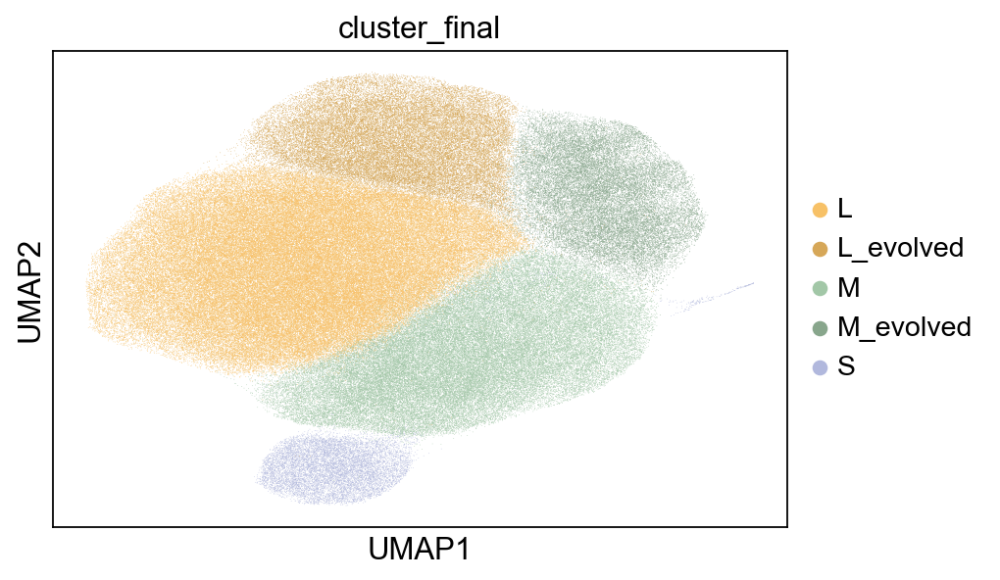

In [ ]:
sc.set_figure_params(figsize=(6, 4))
sc.pl.umap(adata, 
           color=["cluster_final"],
           palette={'L':"#F7C167",'L_evolved':"#d6a758",'M':"#A2C7A7",'M_evolved':"#88a68c",'S':"#B1B8DD"},
           save="cluster_final.pdf"
          )

In [11]:
# Determine the minimum number of cells in any cluster
min_cells_per_cluster = adata.obs['cluster_final'].value_counts().min()

# Downsample each cluster to have the same number of cells
indices_to_keep = []

for cluster in adata.obs['cluster_final'].unique():
    cluster_indices = adata.obs[adata.obs['cluster_final'] == cluster].index
    sampled_indices = np.random.choice(cluster_indices, min_cells_per_cluster, replace=False)
    indices_to_keep.extend(sampled_indices)

# Create a new AnnData object with the downsampled cells
adata_downsampled = adata[indices_to_keep, :].copy()

In [25]:
adata_downsampled.obs['sample_cluster'] = (adata_downsampled.obs['sample'].astype(str) + "_" + adata_downsampled.obs['cluster_final'].astype(str)).astype("category")
my_order=['2r_L','4r_L', 'Holiday_L',
          '2r_L_evolved', '4r_L_evolved','Holiday_L_evolved', 
          '2r_M','4r_M','Holiday_M',
          '2r_M_evolved','4r_M_evolved', 'Holiday_M_evolved',
          '2r_S','4r_S','Holiday_S']
# Keep only those that exist
cats = adata_downsampled.obs["sample_cluster"].cat.categories
my_order = [c for c in my_order if c in cats]
adata_downsampled.obs["sample_cluster"] = (adata_downsampled.obs["sample_cluster"].cat.reorder_categories(my_order, ordered=True))
adata_downsampled.obs['sample_cluster'].value_counts()
adata_downsampled

AnnData object with n_obs × n_vars = 55035 × 2507
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'sample', 'n_counts', '_scvi_batch', '_scvi_labels', 'leiden_scVI', 'leiden_scVI2', 'leiden_scVI_final', 'cluster_final', 'sample_cluster'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts'
    uns: '_scvi', 'cluster_final_colors', 'leiden', 'leiden_scVI2_colors', 'leiden_scVI_colors', 'leiden_scVI_final_colors', 'neighbors', 'sample_colors', 'umap'
    obsm: 'X_pca', 'X_scVI', 'X_umap'
    layers: 'scvi_normalized'
    obsp: 'connectivities', 'distances'

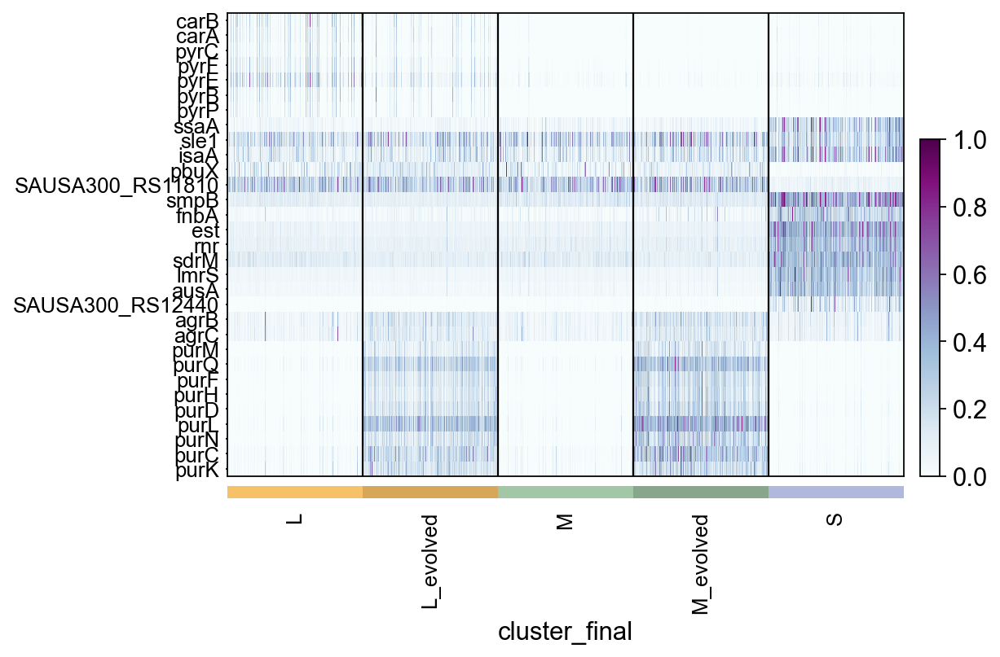

In [29]:
sc.pl.heatmap(
    adata_downsampled,
    ['carB','carA','pyrC','pyrF','pyrE','pyrB','pyrP',#'pflB','nasD','narG',
 'ssaA', 'sle1', 'isaA', 'pbuX', 'SAUSA300_RS11810',
'smpB','fnbA','est','rnr','sdrM','lmrS','ausA','SAUSA300_RS12440',
'agrB','agrC','purM','purQ','purF','purH','purD','purL','purN','purC','purK'],
    groupby='cluster_final',
    layer="scvi_normalized",
    standard_scale="var",
    cmap="BuPu",
    dendrogram=False,
    figsize=(7, 5),
    #palette={'L':"#F7C167",'L_evolved':"#e6b35e",'M':"#A2C7A7",'M_evolved':"#97b89b",'S':"#B1B8DD"}, #'#B1B8DD','#97b89b','#A2C7A7', '#e6b35e','#F7C167']
    swap_axes=True, 
    save="downsample_agr_classcial_marker_cluster.pdf"
)

In [7]:
#the first letter of cluster_final
adata.obs['cluster_general'] = adata.obs['cluster_final'].str[0]
adata.obs['cluster_general'].value_counts()

L    176817
M     99610
S     11007
Name: cluster_general, dtype: int64

In [9]:
# Determine the minimum number of cells in any cluster
min_cells_per_cluster = adata.obs['cluster_general'].value_counts().min()

# Downsample each cluster to have the same number of cells
indices_to_keep = []

for cluster in adata.obs['cluster_general'].unique():
    cluster_indices = adata.obs[adata.obs['cluster_general'] == cluster].index
    sampled_indices = np.random.choice(cluster_indices, min_cells_per_cluster, replace=False)
    indices_to_keep.extend(sampled_indices)

# Create a new AnnData object with the downsampled cells
adata_downsampled = adata[indices_to_keep, :].copy()

KeyError: 'cluster_general'

/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  cax = scatter(
/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_utils.py:432: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


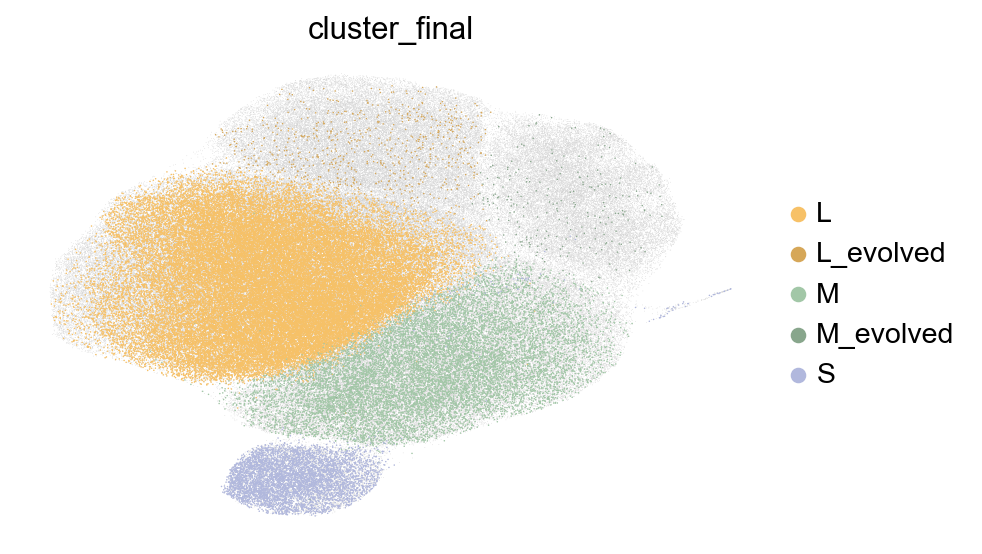

In [115]:
sc.set_figure_params(figsize=(6, 4))

# Create a new figure and axis
fig, ax = plt.subplots()

# First, plot the general UMAP without showing it (show=False)
sc.pl.umap(adata, show=False, ax=ax)

sc.pl.umap(adata[adata.obs['sample'] == '2r'], 
           color=["cluster_final"],
           palette={'L':"#F7C167",'L_evolved':"#d6a758",'M':"#A2C7A7",'M_evolved':"#88a68c",'S':"#B1B8DD"},
           ax=ax,
           frameon=False,
           save="2r.pdf")

/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  cax = scatter(
/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_utils.py:432: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


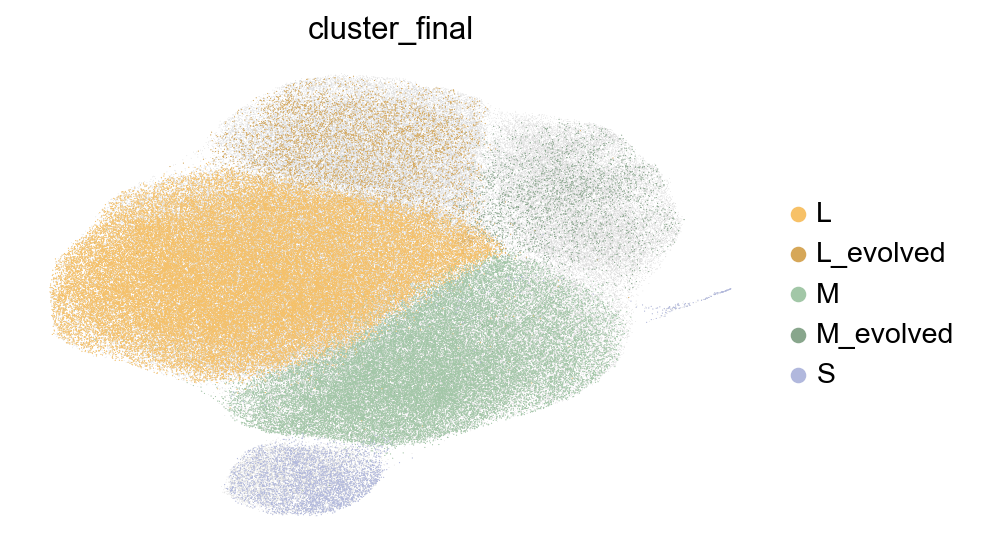

In [116]:
sc.set_figure_params(figsize=(6, 4))

# Create a new figure and axis
fig, ax = plt.subplots()

# First, plot the general UMAP without showing it (show=False)
sc.pl.umap(adata, show=False, ax=ax)

sc.pl.umap(adata[adata.obs['sample'] == '4r'], 
           color=["cluster_final"],
           palette={'L':"#F7C167",'L_evolved':"#d6a758",'M':"#A2C7A7",'M_evolved':"#88a68c",'S':"#B1B8DD"},
           ax=ax,
           frameon=False,
           save="4r.pdf")

/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  cax = scatter(
/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_utils.py:432: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


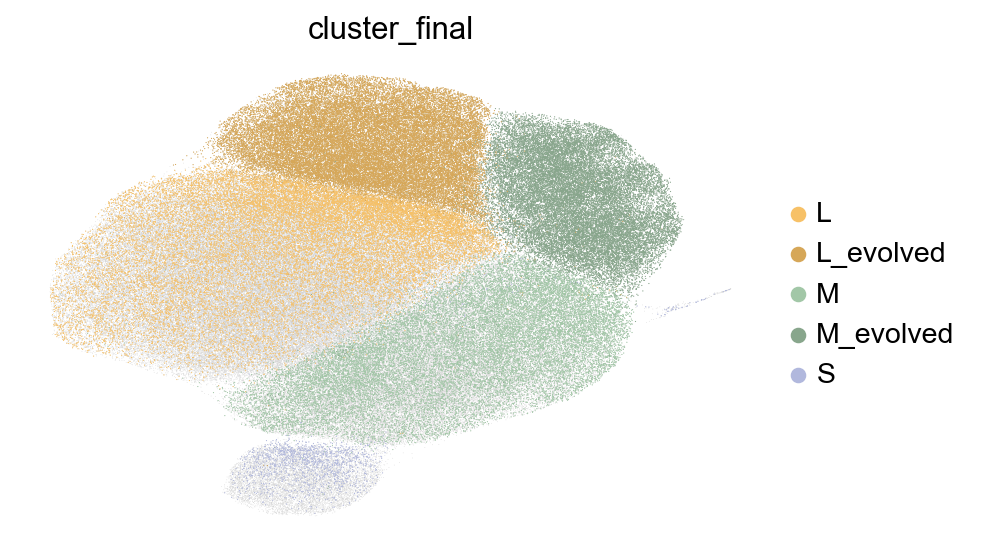

In [117]:
sc.set_figure_params(figsize=(6, 4))

# Create a new figure and axis
fig, ax = plt.subplots()

# First, plot the general UMAP without showing it (show=False)
sc.pl.umap(adata, show=False, ax=ax)

sc.pl.umap(adata[adata.obs['sample'] == 'Holiday'], 
           color=["cluster_final"],
           palette={'L':"#F7C167",'L_evolved':"#d6a758",'M':"#A2C7A7",'M_evolved':"#88a68c",'S':"#B1B8DD"},
           ax=ax,
           frameon=False,
           save="Holiday.pdf")

## PCA

In [118]:
from sklearn.preprocessing import StandardScaler
scvi_data = StandardScaler().fit_transform(adata.layers['scvi_normalized'])
scvi_data = pd.DataFrame(scvi_data,
            index=adata.obs_names,
            columns=adata.var_names)
scvi_data

,dnaA,dnaN,SAUSA300_RS00020,recF,gyrB,gyrA,nnrD,hutH,serS,SAUSA300_RS00055,...,SAUSA300_RS15495,SAUSA300_RS15500,SAUSA300_RS15580,SAUSA300_RS15635,SAUSA300_RS15725,SAUSA300_RS15795,SAUSA300_RS15905,opp-4F,SAUSA300_RS08080,SAUSA300_RS10575
Cell Barcode,,,,,,,,,,,,,,,,,,,,,
BS28141A_bc1_10_bc2_10_bc3_24,-0.851302,-0.949634,-1.067598,-0.486327,-1.508042,-1.650315,-0.552761,-0.486601,-0.861226,-0.732574,...,-0.035531,-0.052191,-0.426658,-0.658248,-1.696375,-1.517042,-2.073546,-1.474315,-0.640184,-0.102121
BS28141A_bc1_10_bc2_10_bc3_52,-0.223181,-0.323572,0.680720,-0.398817,-0.431354,-0.441645,0.159919,-0.351548,-0.177496,-0.713129,...,-0.031430,-0.050760,-0.185841,-0.329472,1.134333,-1.163249,0.864819,-0.558688,-0.101815,-0.070810
BS28141A_bc1_10_bc2_10_bc3_96,-0.826531,-0.908495,-0.827741,0.041900,-0.644028,-0.374474,-0.446222,-0.626157,0.494651,-0.182061,...,-0.033355,-0.054215,-0.264384,-0.500541,0.176363,-0.534940,-0.287576,1.001921,-0.424627,-0.088379
BS28141A_bc1_10_bc2_11_bc3_16,3.145777,2.593172,0.458925,0.710848,0.559179,1.277671,0.162986,0.181462,-1.002980,0.707686,...,-0.011411,-0.024244,0.200387,0.461013,0.750769,0.947029,1.905005,-1.078314,0.252678,0.055835
BS28141A_bc1_10_bc2_11_bc3_45,-0.329253,-0.502285,-0.603208,-0.247879,-0.715378,-0.487677,-0.310391,-0.501278,-1.280359,-0.498263,...,-0.032551,-0.053899,-0.549209,-0.391935,0.126757,-0.631812,0.786571,-0.290360,-0.283545,-0.084689
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
BS28148A_bc1_9_bc2_96_bc3_83,-0.422707,-0.335413,0.838218,-0.330158,-0.487356,-0.022362,-0.094905,-0.341016,-0.221877,-0.340249,...,-0.029331,-0.050287,-0.413361,-0.265691,0.963395,-0.638068,1.465232,1.315306,0.190820,-0.066067
BS28148A_bc1_9_bc2_9_bc3_41,-0.606619,-0.548950,-0.777238,-2.066396,-2.322669,-2.491909,10.830771,5.064248,-1.878662,-0.197741,...,0.105827,0.295513,4.480796,8.643404,-1.519685,-0.709401,-1.366901,1.241667,5.427335,0.596108
BS28148A_bc1_9_bc2_9_bc3_44,-0.779251,-0.898848,-1.941296,-2.145996,-2.843727,-2.917298,7.613731,4.020821,-2.609208,-0.623489,...,0.043329,0.031143,3.453486,5.336441,-3.090585,-2.225217,-2.210724,-2.157195,3.684821,0.183219


In [122]:
from sklearn.decomposition import PCA
pca = PCA(n_components=20)  # Adjust the number of components as needed
pca_results = pca.fit_transform(scvi_data)

In [123]:
adata.obsm['X_pca'] = pca_results

In [124]:
pca.explained_variance_ratio_

array([0.25791371, 0.1782957 , 0.09743798, 0.06268708, 0.05761843,
       0.05441867, 0.04899671, 0.03191652, 0.02944675, 0.02578596,
       0.01898097, 0.01479634, 0.01457236, 0.01152613, 0.00859803,
       0.00684706, 0.00597902, 0.00463804, 0.00400337, 0.00367684])

/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' wil

/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


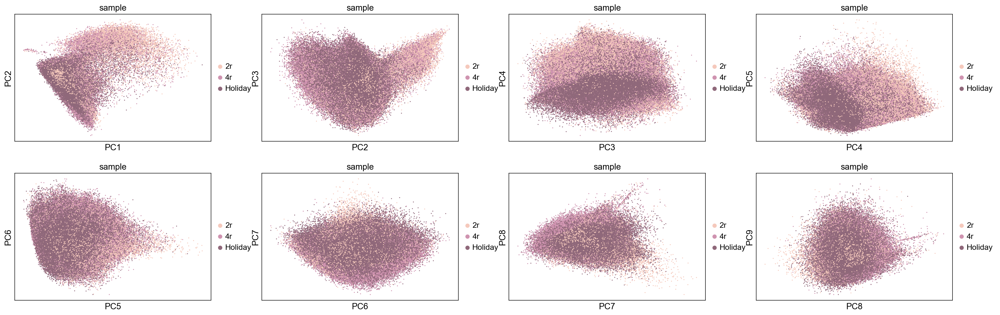

In [130]:
sc.pl.pca(adata, color='sample', components=['1,2', '2,3', '3,4', '4,5','5,6','6,7','7,8','8,9'],
          size=10, #adjust cell point size
          palette=['#F5C9BC','#cf93b0','#8f687a'],
         save="PCA_sample.pdf")

/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' wil

/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


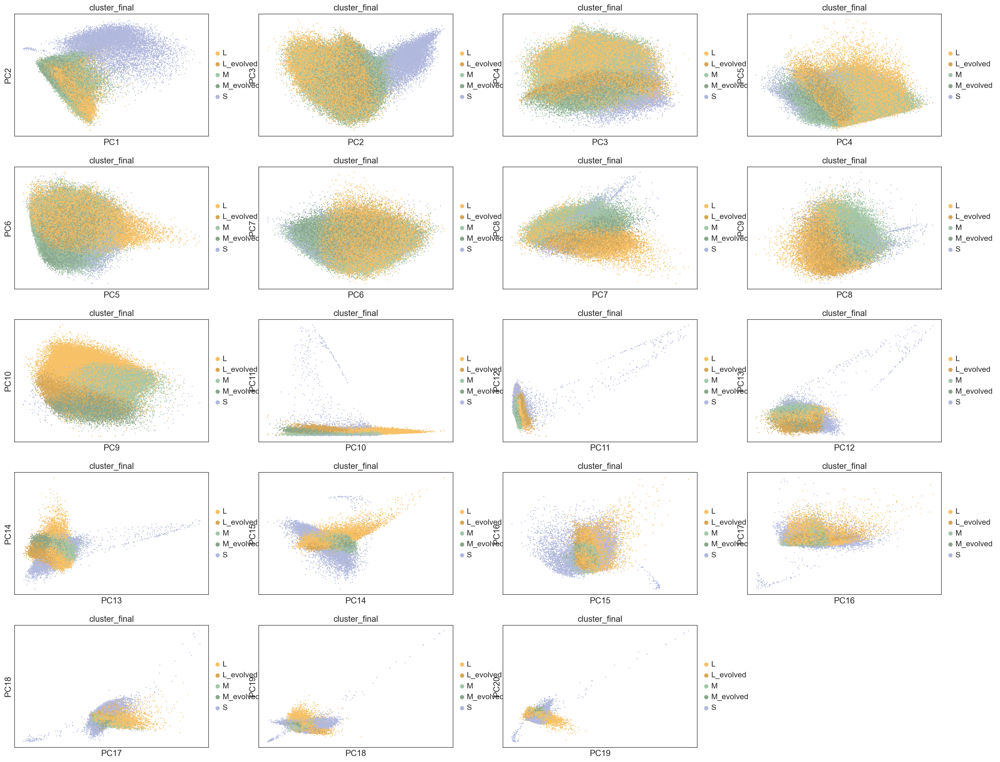

In [139]:
sc.pl.pca(adata, color='cluster_final', 
          components=['1,2', '2,3', '3,4', '4,5','5,6','6,7','7,8','8,9','9,10','10,11','11,12','12,13','13,14','14,15','15,16','16,17','17,18','18,19','19,20'],
          size=10, #adjust cell point size
          palette={'L':"#F7C167",'L_evolved':"#d6a758",'M':"#A2C7A7",'M_evolved':"#88a68c",'S':"#B1B8DD"},
         save="PCA_cluster_final.pdf")

/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_utils.py:432: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping prov

/Users/peien/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


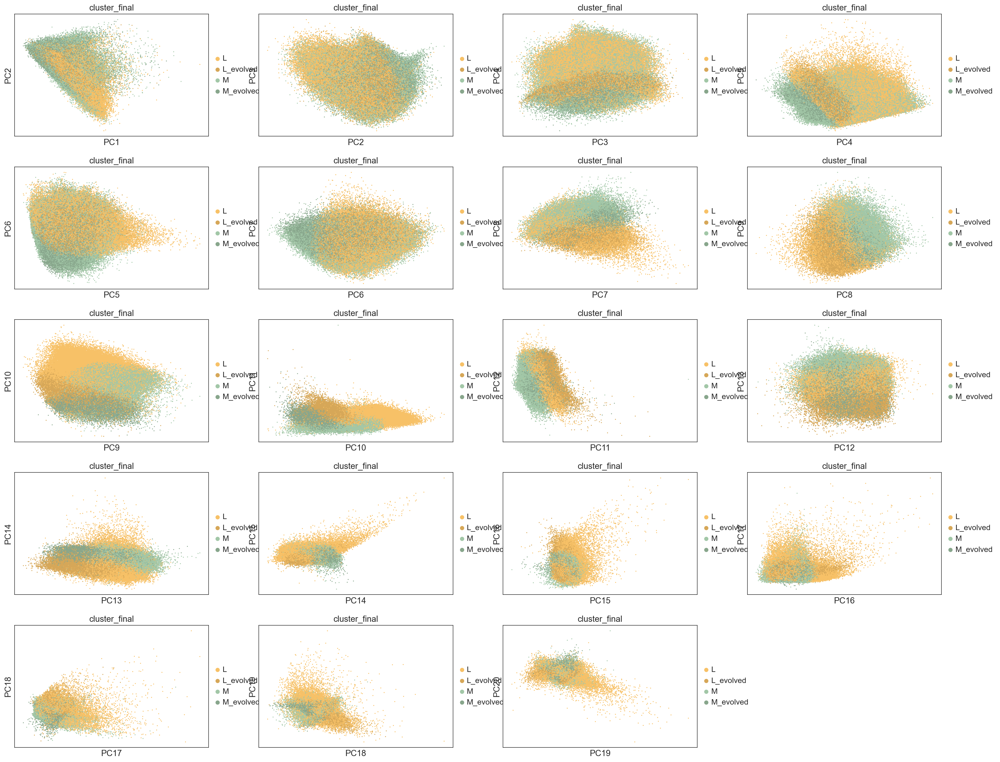

In [140]:
sc.pl.pca(adata[adata.obs['cluster_final']!='S'], color='cluster_final', 
          components=['1,2', '2,3', '3,4', '4,5','5,6','6,7','7,8','8,9','9,10','10,11','11,12','12,13','13,14','14,15','15,16','16,17','17,18','18,19','19,20'],
          size=10, #adjust cell point size
          palette={'L':"#F7C167",'L_evolved':"#d6a758",'M':"#A2C7A7",'M_evolved':"#88a68c",'S':"#B1B8DD"},
         save="PCA_cluster_final_withoutS.pdf")